<a href="https://colab.research.google.com/github/riya123purwar/Wildfire_detection/blob/main/forest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator


IMAGE_WIDTH = 128
IMAGE_HEIGHT = 128
BATCH_SIZE = 32
EPOCHS = 10

# Define data directories
train_dir = '/content/drive/MyDrive/Forest Fire Dataset/Training'
test_dir = '/content/drive/MyDrive/Forest Fire Dataset/Testing'

# Define data generators with data augmentation
# process of artificially generating new data from existing data, primarily to train new machine learning (ML) models.

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,

    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
# The testing data generator only rescales the pixel values.
test_datagen = ImageDataGenerator(rescale=1./255)


# Generate batches of training and testing data
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT),
    batch_size=BATCH_SIZE,
    class_mode='binary'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT),
    batch_size=BATCH_SIZE,
    class_mode='binary'
)

# Define the CNN model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.n // BATCH_SIZE,
    epochs=EPOCHS,
    validation_data=test_generator,
    validation_steps=test_generator.n // BATCH_SIZE
)

# Save the trained model
model.save('forest_fire_detection_model.h5')


Found 1550 images belonging to 2 classes.
Found 0 images belonging to 0 classes.
Epoch 1/10
48/48 [==============================] - 328s 7s/step - loss: 0.2949 - accuracy: 0.8762
Epoch 2/10
48/48 [==============================] - 62s 1s/step - loss: 0.2014 - accuracy: 0.9321
Epoch 3/10
48/48 [==============================] - 59s 1s/step - loss: 0.1712 - accuracy: 0.9486
Epoch 4/10
48/48 [==============================] - 61s 1s/step - loss: 0.1482 - accuracy: 0.9499
Epoch 5/10
48/48 [==============================] - 59s 1s/step - loss: 0.1381 - accuracy: 0.9539
Epoch 6/10
48/48 [==============================] - 59s 1s/step - loss: 0.1471 - accuracy: 0.9499
Epoch 7/10
48/48 [==============================] - 59s 1s/step - loss: 0.1654 - accuracy: 0.9519
Epoch 8/10
48/48 [==============================] - 59s 1s/step - loss: 0.1357 - accuracy: 0.9565
Epoch 9/10
48/48 [==============================] - 60s 1s/step - loss: 0.1102 - accuracy: 0.9618
Epoch 10/10
48/48 [=================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


1/1 [==============================] - 0s 35ms/step
Forest Fire Images:


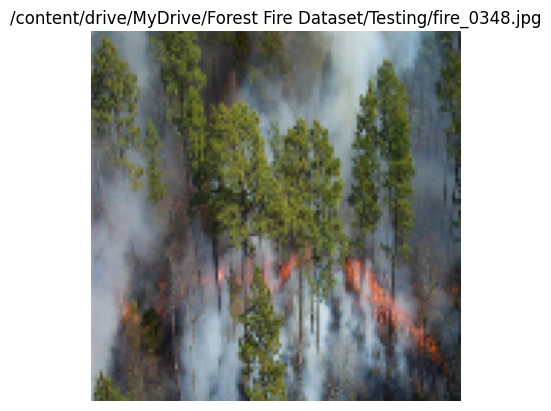

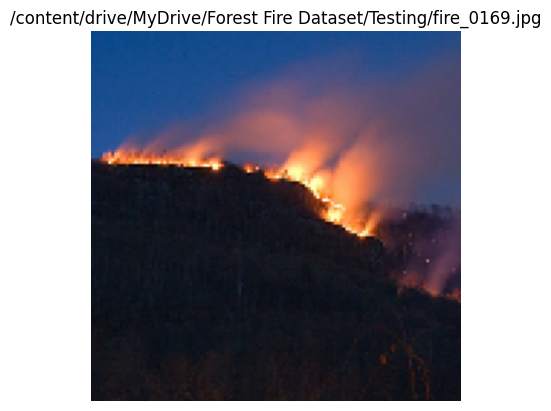

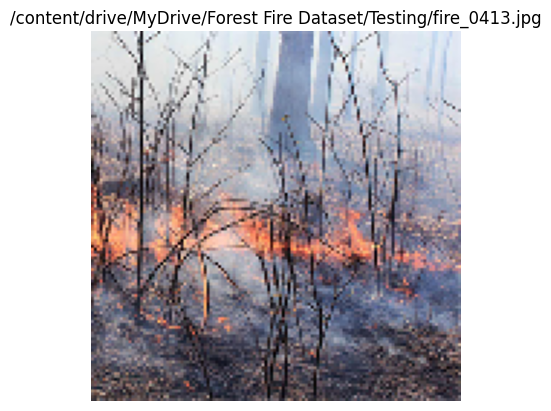

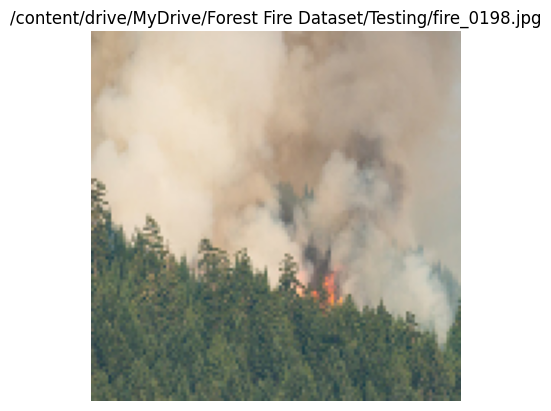

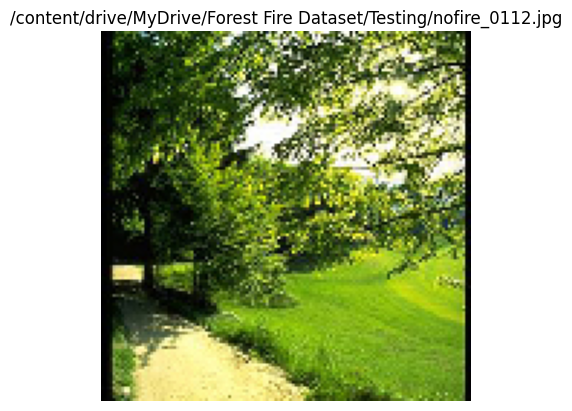

...

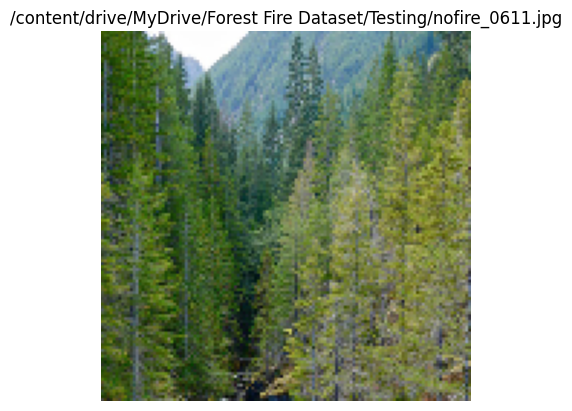

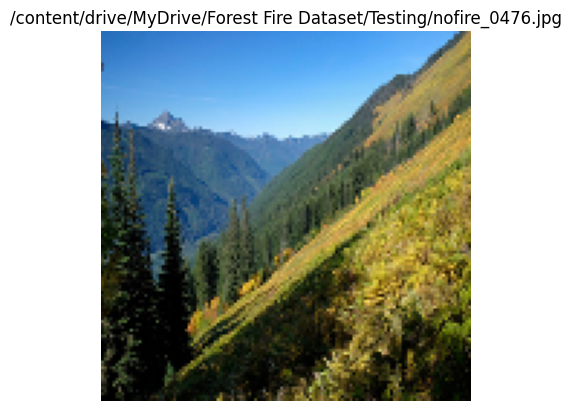

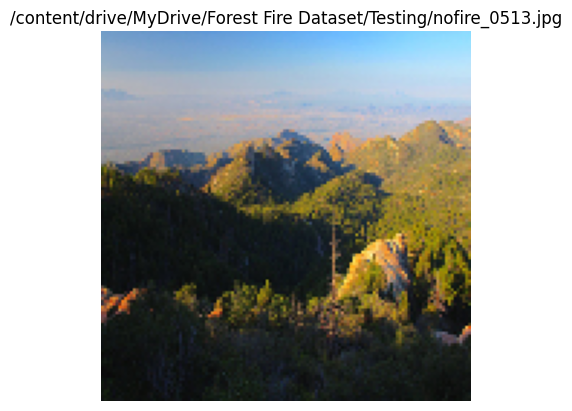

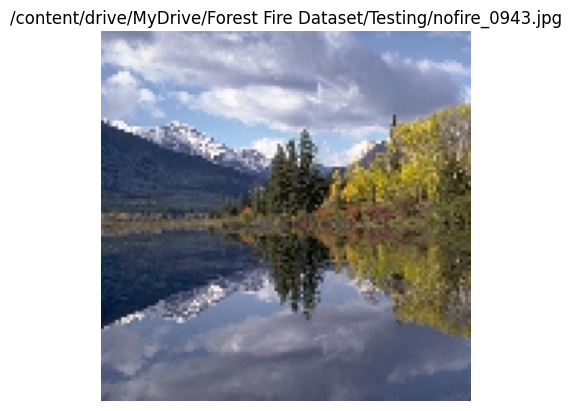

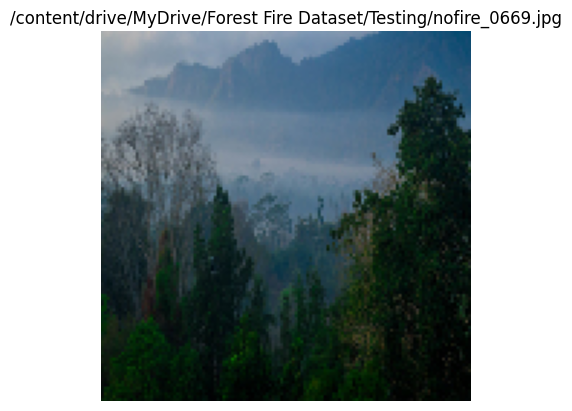

Buffered data was truncated after reaching the output size limit.

In [ ]:
# import os
# import numpy as np
# import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt


model = load_model('forest_fire_detection_model.h5')

# Directory containing testing images
test_images_dir = '/content/drive/MyDrive/Forest Fire Dataset/Testing'


fire_images = []


for image_name in os.listdir(test_images_dir):

    image_path = os.path.join(test_images_dir, image_name)


    img = image.load_img(image_path, target_size=(128, 128))#preprocess the image
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) / 255.0  # Normalize pixel values

    # Perform inference using the model
    prediction = model.predict(img_array)

    # Assuming binary classification: 1 for fire, 0 for no fire
    if prediction > 0.5:

        fire_images.append((image_path, img))

# Print paths of images containing forest fire
print("Forest Fire Images:")
# for image_path in fire_images:
#     print(image_path)


# Display fire images along with their paths
for image_path, img in fire_images:
    plt.figure()
    plt.imshow(img)
    plt.title(image_path)
    plt.axis('off')
    plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

# Load the trained model
model = load_model('forest_fire_detection_model.h5')


def predict_fire(image_path):
    # Load and preprocess the image
    img = image.load_img(image_path, target_size=(128, 128))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) / 255.0  # Normalize pixel values

    # Perform inference using the model
    prediction = model.predict(img_array)

    if prediction > 0.5:
        return "The image does not contains fire."
    else:
        return "The image  contain fire."

# Path to the input image you want to test
input_image_path = '/content/fire_0014.jpg'

# Test the model with the input image
result = predict_fire(input_image_path)
print(result)


1/1 [==============================] - 0s 105ms/step
The image  contain fire.


In [ ]:
# Display the number of fire and no fire images
print("Number of Fire Images:", len(fire_images))
print("Number of No Fire Images:", len(no_fire_images))

Number of Fire Images: 0
Number of No Fire Images: 191


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
